In [13]:
import pandas as pd
import numpy as np

import statsmodels.api as sm
from scipy.stats import t
from sklearn.utils import resample
import matplotlib.pyplot as plt

Numberofsamples = 1000
Time= 120 

mreturn = 0.05
volatility = 0.2 
residual_vol = .1

In [14]:
# Market Excess Return 
monthvolres = residual_vol / np.sqrt(12)  # adjusted extra volatility
mean_market_excess_return = mreturn / 12  # adjusted mean
monthmarvol = volatility / np.sqrt(12)  # Monthly volatility
market_excess_returns = np.random.normal(mean_market_excess_return, monthmarvol, Time)

fund_returns = pd.DataFrame()

# Simulate fund returns
for i in range(Numberofsamples):
    residuals = np.random.normal(0, monthvolres, Time)
    fund_returns[f'Fund_{i}'] = market_excess_returns + residuals

fund_returns['Market_Excess_Return'] = market_excess_returns

C:\Users\Owner\AppData\Local\Temp\ipykernel_26168\3666374273.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  fund_returns[f'Fund_{i}'] = market_excess_returns + residuals
C:\Users\Owner\AppData\Local\Temp\ipykernel_26168\3666374273.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  fund_returns[f'Fund_{i}'] = market_excess_returns + residuals
C:\Users\Owner\AppData\Local\Temp\ipykernel_26168\3666374273.py:12: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many tim

In [15]:
# Part 1: No Skilled Funds 

# Prepare the data for regression
X = sm.add_constant(fund_returns['Market_Excess_Return'])  # Independent variable
alphas = []  # Store alpha estimates
betas = []  # Store beta estimates

# Perform regression for each fund
for i in range(Numberofsamples):
    y = fund_returns[f'Fund_{i}']  # Dependent variable
    model = sm.OLS(y, X).fit()
    alphas.append(model.params[0])  # Intercept (alpha)
    betas.append(model.params[1])  # Slope (beta)

# Convert lists to numpy arrays for easier handling
alphas = np.array(alphas)

# Summary statistics for alphas and betas
alpha_mean = np.mean(alphas)
alpha_std = np.std(alphas)
beta_mean = np.mean(betas)
beta_std = np.std(betas)

print(f'Alpha Mean: {alpha_mean:.5f}')
print(f'Alpha Standard Deviation: {alpha_std:.5f}')
print(f'Beta Mean: {beta_mean:.5f}')
print(f'Beta Standard Deviation: {beta_std:.5f}')



C:\Users\Owner\AppData\Local\Temp\ipykernel_26168\1272273058.py:12: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  alphas.append(model.params[0])  # Intercept (alpha)
C:\Users\Owner\AppData\Local\Temp\ipykernel_26168\1272273058.py:13: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  betas.append(model.params[1])  # Slope (beta)


Alpha Mean: 0.00014
Alpha Standard Deviation: 0.00262
Beta Mean: 0.99789
Beta Standard Deviation: 0.04911


C:\Users\Owner\AppData\Local\Temp\ipykernel_26168\1474896394.py:13: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  fund_returns[f'Fund_{i}'] = market_excess_returns + residuals
C:\Users\Owner\AppData\Local\Temp\ipykernel_26168\1474896394.py:14: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  residuals_df[f'Fund_{i}'] = residuals
C:\Users\Owner\AppData\Local\Temp\ipykernel_26168\1474896394.py:13: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor perfo

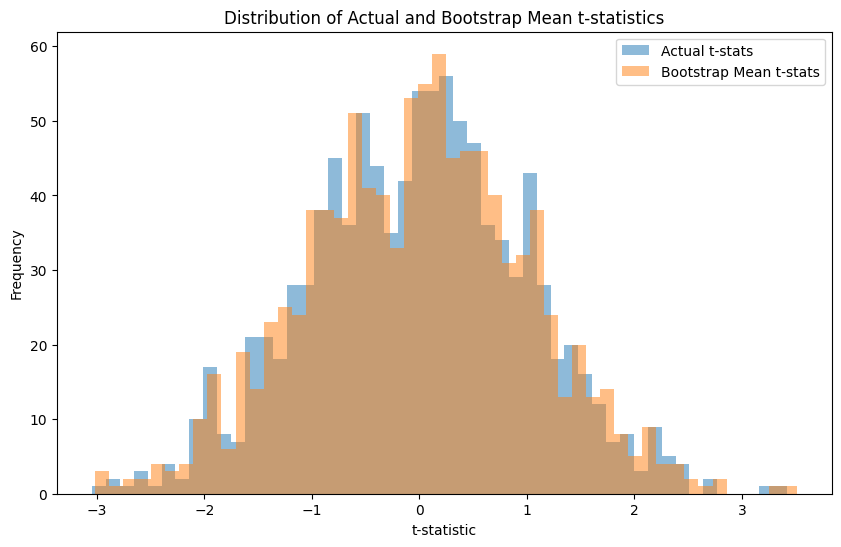

In [16]:
Boots = 100  # Number of bootstrap samples

# Simulate market excess returns
market_excess_returns = np.random.normal(mean_market_excess_return, monthmarvol, Time)

# Initialize DataFrame to store fund returns and residuals
fund_returns = pd.DataFrame()
residuals_df = pd.DataFrame()

# Simulate fund returns and residuals
for i in range(Numberofsamples):
    residuals = np.random.normal(0, vol_residual, Time)
    fund_returns[f'Fund_{i}'] = market_excess_returns + residuals
    residuals_df[f'Fund_{i}'] = residuals

# Perform regression analysis to estimate alpha, beta, and residuals
alphas = []
betas = []
t_stats = []
for i in range(N):
    y = fund_returns[f'Fund_{i}']
    X = sm.add_constant(market_excess_returns)
    model = sm.OLS(y, X).fit()
    alphas.append(model.params[0])
    betas.append(model.params[1])
    t_stats.append(model.tvalues[0])

# Bootstrap algorithm
bootstrap_t_stats = np.zeros((Boots, Numberofsamples))
for b in range(B):
    # Draw a bootstrap sample of 120 months
    bootstrap_sample = resample(range(Time), replace=True, n_samples=Time)
    # For each fund, construct a bootstrap time-series of zero-skill excess returns
    for i in range(N):
        bootstrap_returns = betas[i] * market_excess_returns[bootstrap_sample] + residuals_df.iloc[bootstrap_sample, i]
        X_bootstrap = sm.add_constant(market_excess_returns[bootstrap_sample])
        model_bootstrap = sm.OLS(bootstrap_returns, X_bootstrap).fit()
        bootstrap_t_stats[b, i] = model_bootstrap.tvalues[0]

# Calculate the average, 5th, and 95th percentiles of bootstrap t-stats
bootstrap_t_stats_mean = np.mean(bootstrap_t_stats, axis=0)
bootstrap_t_stats_5th = np.percentile(bootstrap_t_stats, 5, axis=0)
bootstrap_t_stats_95th = np.percentile(bootstrap_t_stats, 95, axis=0)

# Plotting
plt.figure(figsize=(10, 6), facecolor='white')
plt.hist(t_stats, bins=50, alpha=0.5, label='Actual t-stats')
plt.hist(bootstrap_t_stats_mean, bins=50, alpha=0.5, label='Bootstrap Mean t-stats')
plt.legend()
plt.xlabel('t-statistic')
plt.ylabel('Frequency')
plt.title('Distribution of Actual and Bootstrap Mean t-statistics')
plt.show()



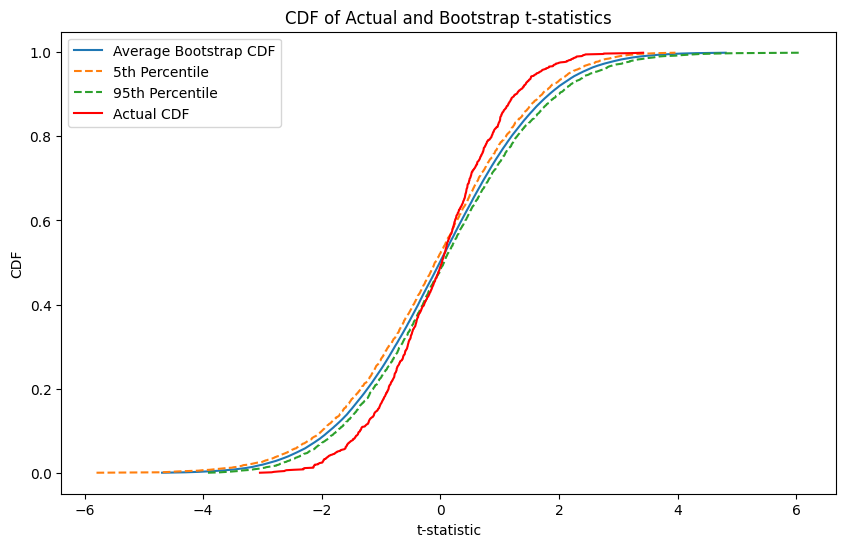

Plotting completed.


In [17]:

sorted_bootstrap_t_stats = np.sort(bootstrap_t_stats, axis=1)


average_t_stats = np.mean(sorted_bootstrap_t_stats, axis=0)
percentile_5th_t_stats = np.percentile(sorted_bootstrap_t_stats, 5, axis=0)
percentile_95th_t_stats = np.percentile(sorted_bootstrap_t_stats, 95, axis=0)


sorted_actual_t_stats = np.sort(t_stats)
cdf_actual_t_stats = np.array(range(Numberofsamples)) / float(Numberofsamples)


plt.figure(figsize=(10, 6), facecolor='white')
plt.plot(average_t_stats, cdf_actual_t_stats, label='Average Bootstrap CDF')
plt.plot(percentile_5th_t_stats, cdf_actual_t_stats, linestyle='--', label='5th Percentile')
plt.plot(percentile_95th_t_stats, cdf_actual_t_stats, linestyle='--', label='95th Percentile')
plt.plot(sorted_actual_t_stats, cdf_actual_t_stats, label='Actual CDF', color='red')
plt.legend()
plt.xlabel('t-statistic')
plt.ylabel('CDF')
plt.title('CDF of Actual and Bootstrap t-statistics')
plt.show()

print('Plotting completed.')


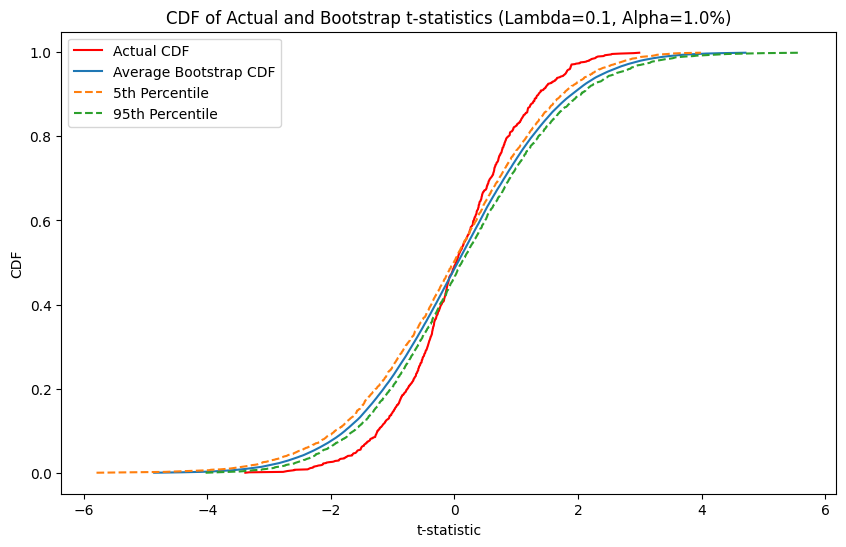

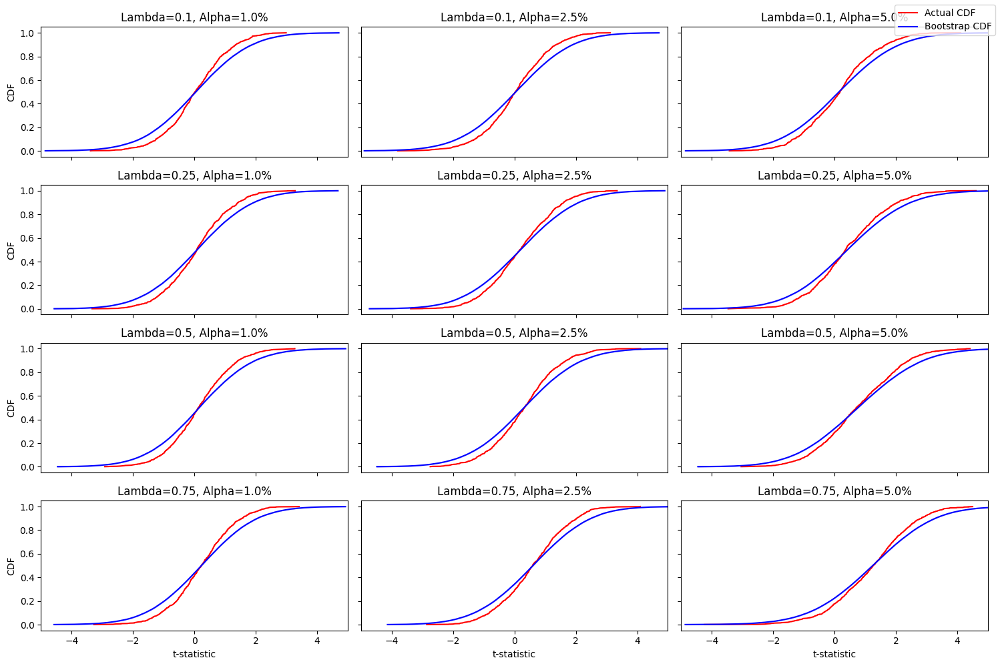

In [18]:

# Constants

mean_market_excess_return = 0.05 / 12  # Monthly mean
vol_market_excess_return = 0.2 / np.sqrt(12)  # Monthly volatility
vol_residual = 0.1 / np.sqrt(12)  # Monthly residual volatility
lambdas = [0.1, 0.25, 0.5, 0.75]  # Fraction of skilled funds
alphas_per_year = [0.01, 0.025, 0.05]  # True alpha values per year

# Simulate market excess returns
market_excess_returns = np.random.normal(mean_market_excess_return, vol_market_excess_return, Time)

# Placeholder for results
results = []

# Process for each lambda and alpha
for lambda_val in lambdas:
    for alpha_per_year in alphas_per_year:
        # Number of skilled funds
        num_skilled = int(Numberofsamples * lambda_val)
        alpha_monthly = alpha_per_year / 12  # Convert yearly alpha to monthly

        # Initialize lists for fund returns and residuals
        fund_returns_list = []
        residuals_list = []
        
        # Simulate fund returns and residuals, incorporating skilled funds
        for i in range(N):
            residuals = np.random.normal(0, vol_residual, Time)
            fund_return = alpha_monthly + market_excess_returns + residuals if i < num_skilled else market_excess_returns + residuals
            # Append the returns and residuals for each fund to the lists
            fund_returns_list.append(fund_return)
            residuals_list.append(residuals)
        
        # Convert lists to DataFrames
        fund_returns = pd.DataFrame(fund_returns_list).T
        fund_returns.columns = [f'Fund_{i}' for i in range(Numberofsamples)]
        residuals_df = pd.DataFrame(residuals_list).T
        residuals_df.columns = [f'Fund_{i}' for i in range(Numberofsamples)]

        # Perform regression analysis to estimate alpha, beta, and residuals
        t_stats = []
        for i in range(Numberofsamples):
            y = fund_returns.iloc[:, i]
            X = sm.add_constant(market_excess_returns)
            model = sm.OLS(y, X).fit()
            t_stats.append(model.tvalues.iloc[0])

        
        # Bootstrap algorithm
        bootstrap_t_stats = np.zeros((B, N))
        for b in range(B):
            # Draw a bootstrap sample
            bootstrap_sample = resample(range(T), replace=True, n_samples=T)
            for i in range(N):
                bootstrap_returns = fund_returns.iloc[bootstrap_sample, i]
                X_bootstrap = sm.add_constant(market_excess_returns[bootstrap_sample])
                model_bootstrap = sm.OLS(bootstrap_returns, X_bootstrap).fit()
                bootstrap_t_stats[b, i] = model_bootstrap.tvalues.iloc[0]
        
        # Calculate the average, 5th, and 95th percentiles of bootstrap t-stats
        bootstrap_t_stats_mean = np.mean(bootstrap_t_stats, axis=0)
        bootstrap_t_stats_5th = np.percentile(bootstrap_t_stats, 5, axis=0)
        bootstrap_t_stats_95th = np.percentile(bootstrap_t_stats, 95, axis=0)
        
        # Sort the bootstrap t-stats for each bootstrap sample
        sorted_bootstrap_t_stats = np.sort(bootstrap_t_stats, axis=1)
        
        # Calculate the average, 5th, and 95th percentiles across bootstrap samples at each rank
        average_t_stats = np.mean(sorted_bootstrap_t_stats, axis=0)
        percentile_5th_t_stats = np.percentile(sorted_bootstrap_t_stats, 5, axis=0)
        percentile_95th_t_stats = np.percentile(sorted_bootstrap_t_stats, 95, axis=0)
        
        # Calculate the CDF of actual estimated alpha t-statistics
        sorted_actual_t_stats = np.sort(t_stats)
        cdf_actual_t_stats = np.array(range(N)) / float(N)
        
        # Store results for plotting
        results.append({
            'lambda': lambda_val,
            'alpha_per_year': alpha_per_year,
            'average_t_stats': average_t_stats,
            'percentile_5th_t_stats': percentile_5th_t_stats,
            'percentile_95th_t_stats': percentile_95th_t_stats,
            'sorted_actual_t_stats': sorted_actual_t_stats,
            'cdf_actual_t_stats': cdf_actual_t_stats
        })

# To keep the execution manageable within this environment, we'll proceed to plot for one of the scenarios.
# Selecting a scenario for demonstration
selected_result = results[0]  # Example: first scenario

# Plotting for the selected scenario
plt.figure(figsize=(10, 6), facecolor='white')
plt.plot(selected_result['sorted_actual_t_stats'], selected_result['cdf_actual_t_stats'], label='Actual CDF', color='red')
plt.plot(selected_result['average_t_stats'], selected_result['cdf_actual_t_stats'], label='Average Bootstrap CDF')
plt.plot(selected_result['percentile_5th_t_stats'], selected_result['cdf_actual_t_stats'], linestyle='--', label='5th Percentile')
plt.plot(selected_result['percentile_95th_t_stats'], selected_result['cdf_actual_t_stats'], linestyle='--', label='95th Percentile')
plt.legend()
plt.xlabel('t-statistic')
plt.ylabel('CDF')
plt.title(f'CDF of Actual and Bootstrap t-statistics (Lambda={selected_result["lambda"]}, Alpha={selected_result["alpha_per_year"]*100}%)')
plt.show()


# Function to calculate CDF from data
def calculate_cdf(data):
    sorted_data = np.sort(data)
    cdf = np.arange(1, len(sorted_data) + 1) / len(sorted_data)
    return sorted_data, cdf

# Plotting for one of the scenarios for demonstration
fig, axs = plt.subplots(len(lambdas), len(alphas_per_year), figsize=(15, 10), sharex=True, sharey=True)

for i, lambda_val in enumerate(lambdas):
    for j, alpha_per_year in enumerate(alphas_per_year):
        idx = i * len(alphas_per_year) + j
        result = results[idx]
        
        # Calculate the CDF of actual and bootstrap t-statistics
        actual_sorted, actual_cdf = calculate_cdf(result['sorted_actual_t_stats'])
        bootstrap_sorted, bootstrap_cdf = calculate_cdf(result['average_t_stats'])

        axs[i, j].plot(actual_sorted, actual_cdf, label='Actual CDF', color='red')
        axs[i, j].plot(bootstrap_sorted, bootstrap_cdf, label='Bootstrap CDF', color='blue')
        axs[i, j].fill_between(bootstrap_sorted, calculate_cdf(result['percentile_5th_t_stats'])[1], calculate_cdf(result['percentile_95th_t_stats'])[1], color='blue', alpha=0.2)
        axs[i, j].set_title(f'Lambda={lambda_val}, Alpha={alpha_per_year*100}%')
        axs[i, j].set_xlim([-5, 5])
        
        if i == len(lambdas) - 1:
            axs[i, j].set_xlabel('t-statistic')
        if j == 0:
            axs[i, j].set_ylabel('CDF')

# Adding legend to the last subplot for clarity
handles, labels = axs[-1, -1].get_legend_handles_labels()
fig.legend(handles, labels, loc='upper right')

plt.tight_layout()
plt.show()